<a href="https://colab.research.google.com/github/MarriumJilani/Comparative-Analysis-of-Human-Pose-Estimation-Models-for-Yoga-Poses/blob/main/MediaPipe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install kaggle


In [ ]:
from google.colab import files

# Upload kaggle.json
uploaded = files.upload()

# Move the uploaded file to the correct location
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


Saving kaggle.json to kaggle.json


In [ ]:
# Replace 'dataset-url' with the actual URL of the dataset
!kaggle datasets download -d niharika41298/yoga-poses-dataset



 96% 277M/288M [00:01<00:00, 186MB/s]
100% 288M/288M [00:01<00:00, 151MB/s]


In [ ]:
# Unzip the downloaded dataset
!unzip -q /content/yoga-poses-dataset.zip -d dataset

In [ ]:
!ls
!ls /content/dataset
!ls /content/dataset/DATASET
!ls /content/dataset/DATASET/TEST
!ls /content/dataset/DATASET/TRAIN

dataset  sample_data  yoga-poses-dataset.zip
DATASET
TEST  TRAIN
downdog  goddess  plank  tree  warrior2
downdog  goddess  plank  tree  warrior2


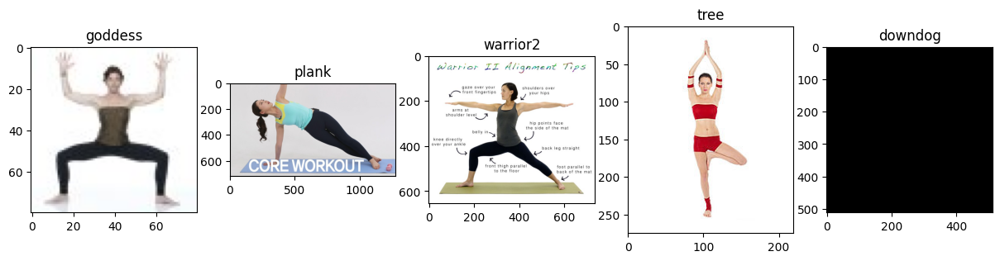

In [ ]:
import os
# Load the dataset
data_path = '/content/dataset/DATASET'
train_path = os.path.join(data_path, 'TRAIN')
test_path = os.path.join(data_path, 'TEST')

# Use the OS library to list classes in the dataset
classes = os.listdir(train_path)

# Visualize one sample for each class
import matplotlib.pyplot as plt
import cv2

# Display one sample image for each class
fig, axes = plt.subplots(1, len(classes), figsize=(15, 5))

for i, class_label in enumerate(classes):
    class_path = os.path.join(train_path, class_label)
    sample_image = os.path.join(class_path, os.listdir(class_path)[0])
    image = cv2.imread(sample_image)
    axes[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axes[i].set_title(class_label)

plt.show()




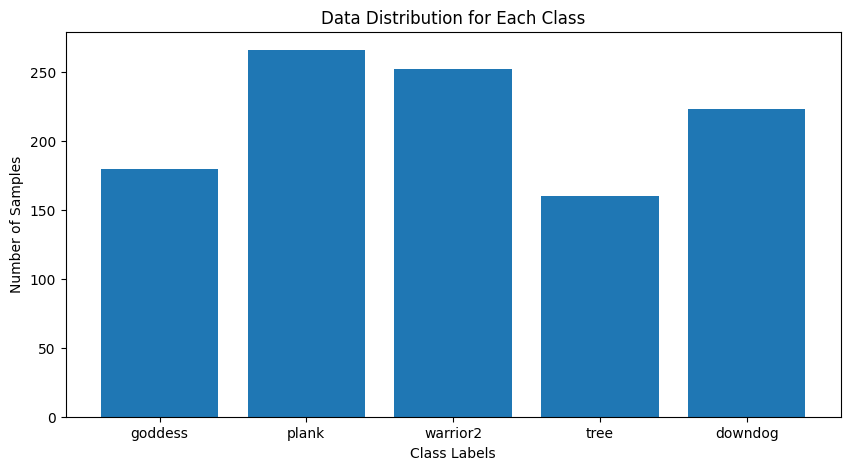

In [ ]:
# Graphical data distribution for each class using a bar chart
class_counts = {class_label: len(os.listdir(os.path.join(train_path, class_label))) for class_label in classes}

plt.figure(figsize=(10, 5))
plt.bar(class_counts.keys(), class_counts.values())
plt.title("Data Distribution for Each Class")
plt.xlabel("Class Labels")
plt.ylabel("Number of Samples")
plt.show()

# Check for class imbalances
min_samples = min(class_counts.values())
max_samples = max(class_counts.values())
class_imbalance_threshold = 0.8

if max_samples / min_samples > class_imbalance_threshold:
    print("Warning: There might be class imbalance.")
else:
    print("No significant class imbalance observed.")

In [ ]:
import cv2

# Load an example image from your dataset
example_image_path = "/content/dataset/DATASET/TEST/downdog/00000000.jpg"
example_image = cv2.imread(example_image_path)

# Get the image dimensions
img_height, img_width, _ = example_image.shape

print("Image Height:", img_height)
print("Image Width:", img_width)


Image Height: 720
Image Width: 1280


In [ ]:
!pip install mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 14.1 MB/s eta 0:00:00


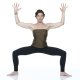

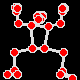

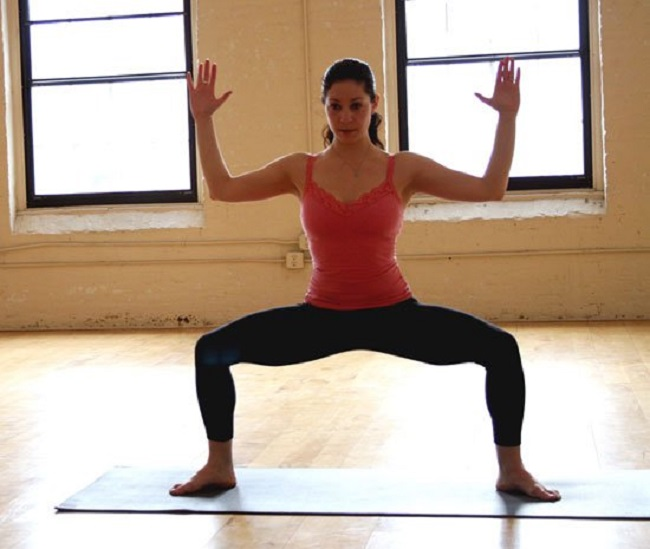

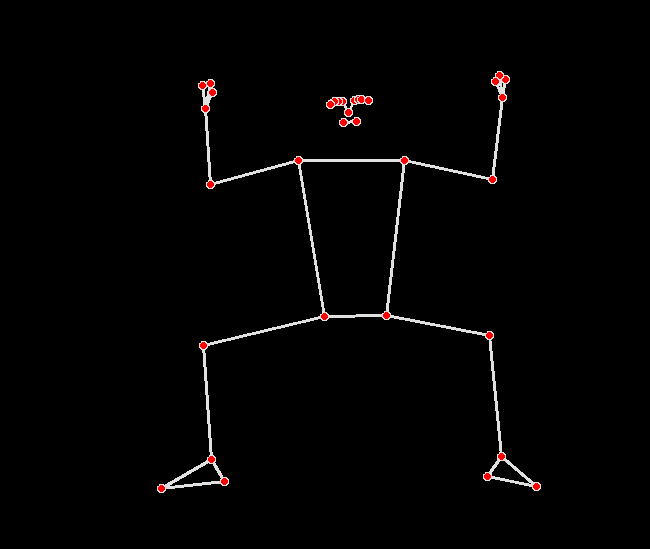

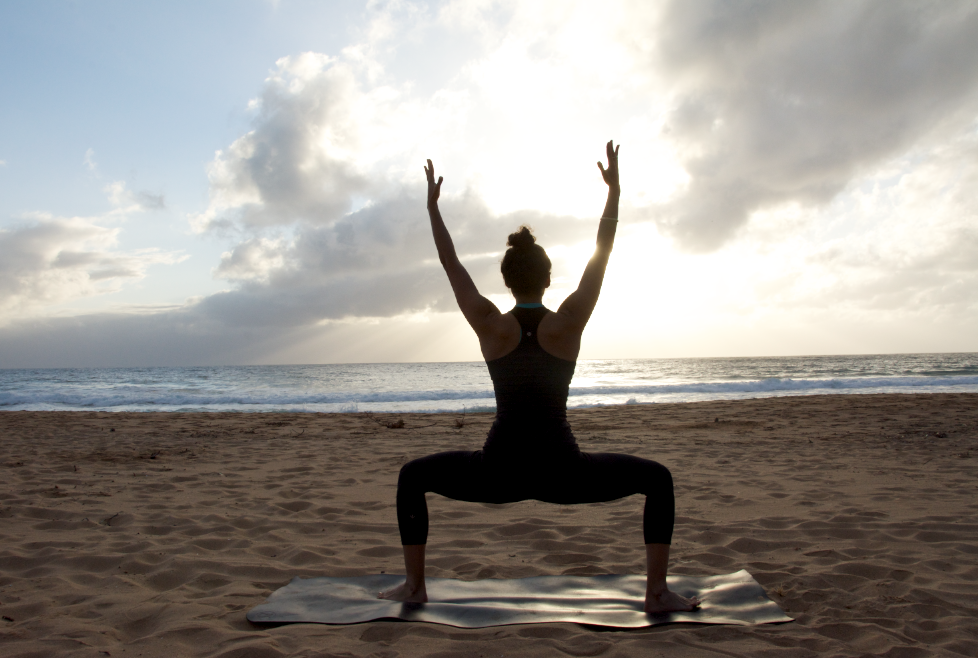

...

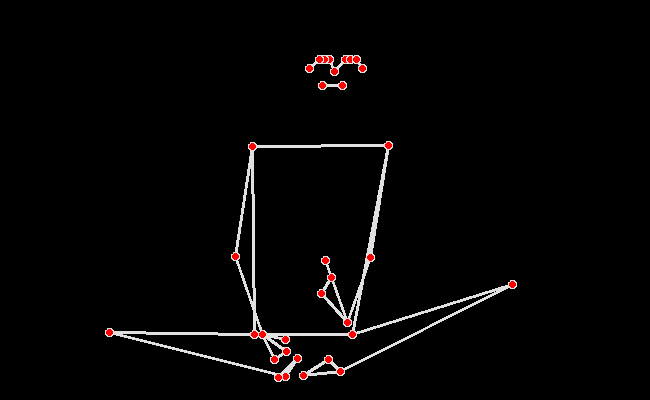

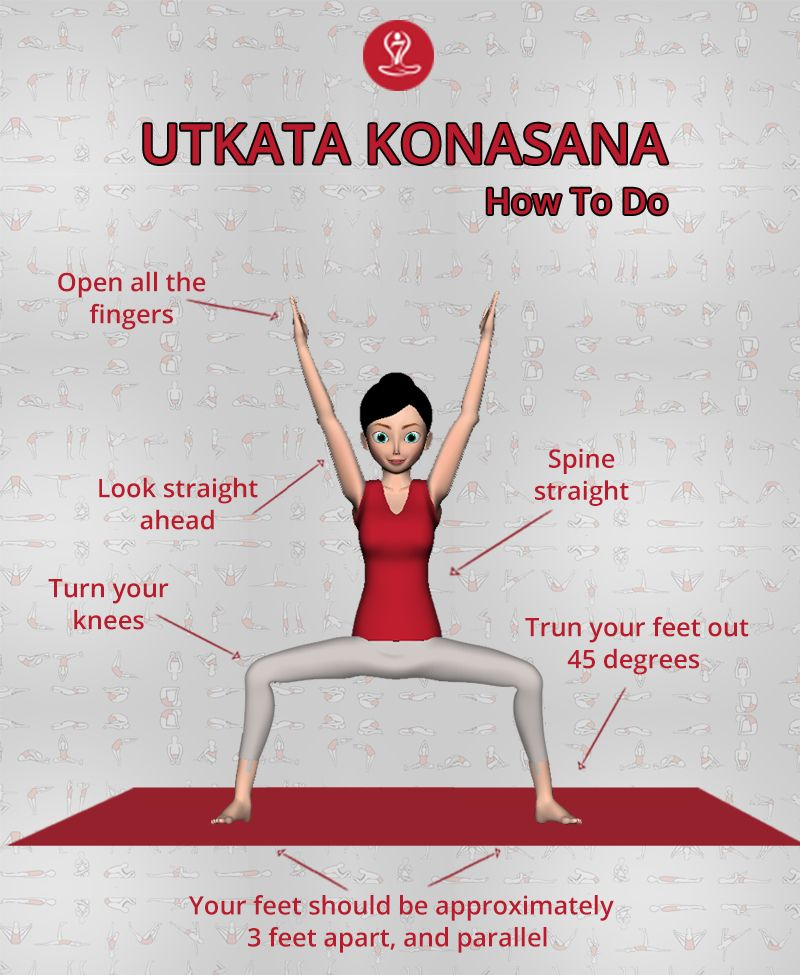

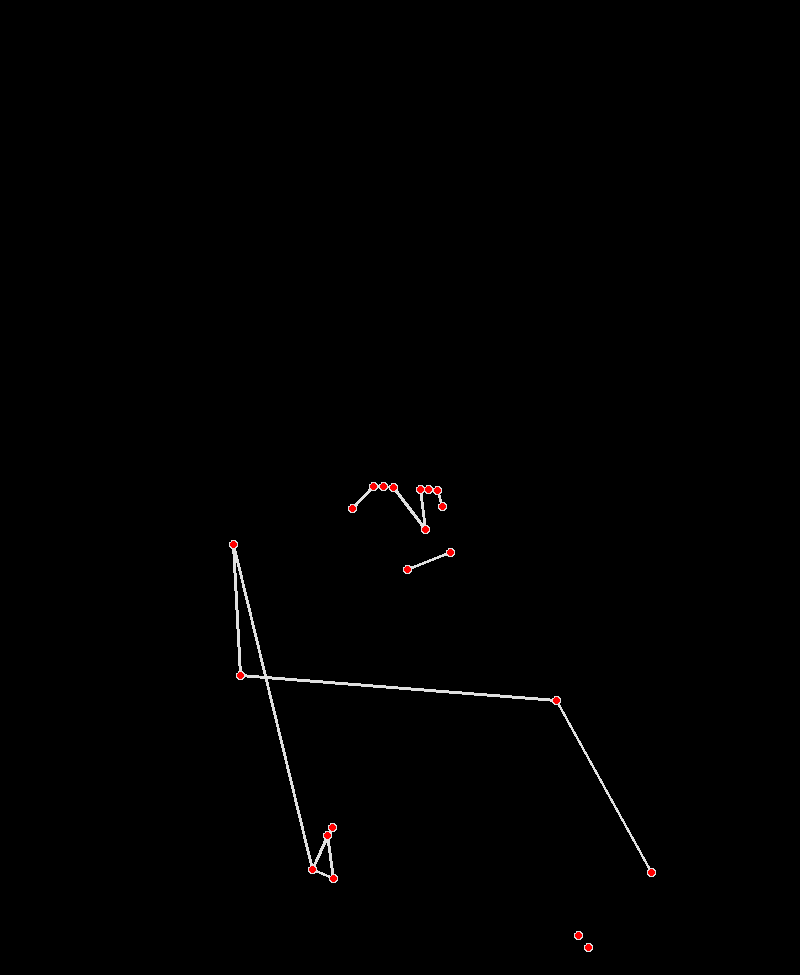

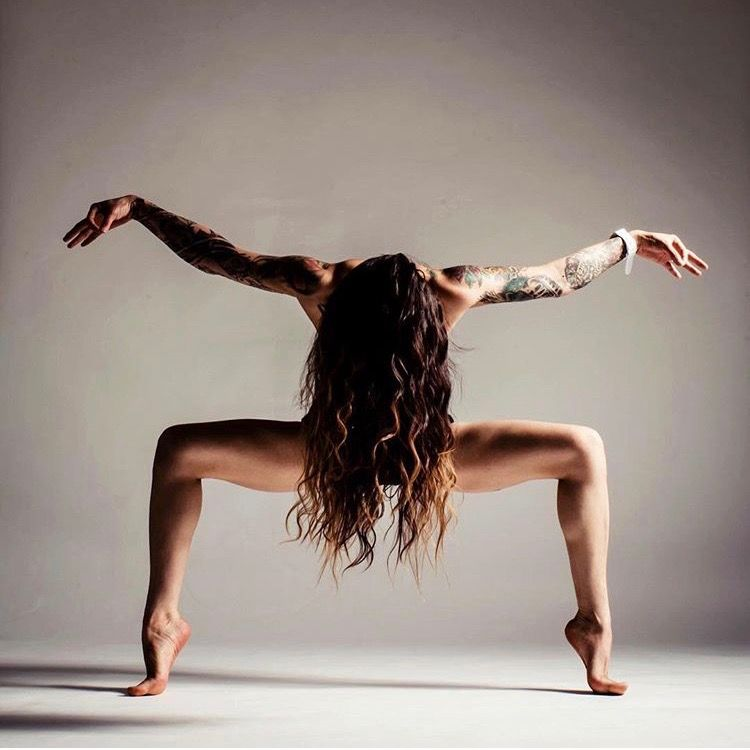

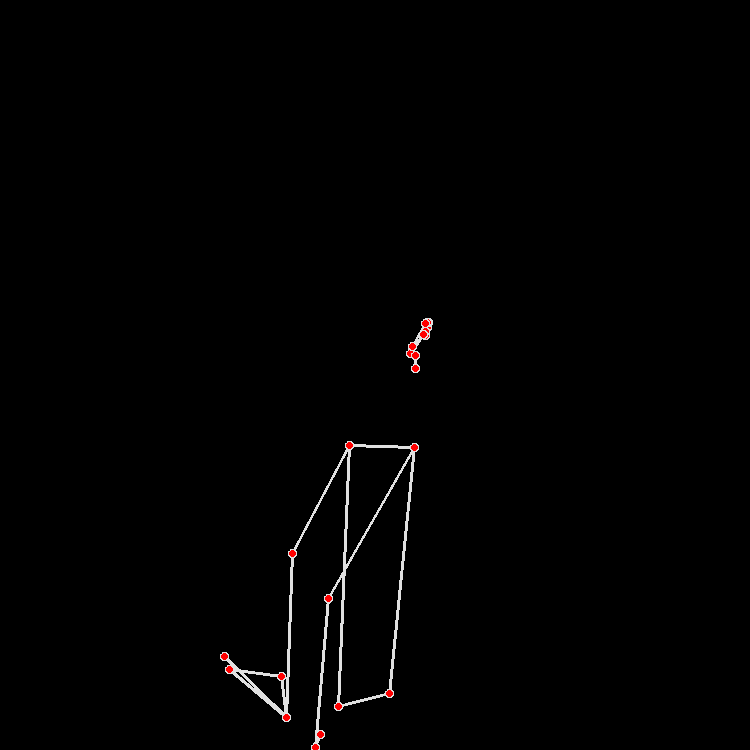

Buffered data was truncated after reaching the output size limit.

In [ ]:
import mediapipe as mp
import cv2
import numpy as np
import pandas as pd
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
import seaborn as sns
import matplotlib.pyplot as plt
import os
from google.colab.patches import cv2_imshow

# Step 1: Prepare Dataset for Pose Estimation
mpPose = mp.solutions.pose
pose = mpPose.Pose()
mpDraw = mp.solutions.drawing_utils
points = mpPose.PoseLandmark
dataset_path = "/content/dataset/DATASET/TRAIN"  # Update with your dataset path
data = []

# Define columns for the dataset
for p in points:
    x = str(p)[13:]
    data.append(x + "_x")
    data.append(x + "_y")
    data.append(x + "_z")
    data.append(x + "_vis")

data.append("target")  # Add target column
data = pd.DataFrame(columns=data)  # Empty dataset
count = 0

class_labels = os.listdir(dataset_path)

for class_label in class_labels:
    class_path = os.path.join(dataset_path, class_label)
    for img in os.listdir(class_path):
        temp = []
        img_path = os.path.join(class_path, img)
        img = cv2.imread(img_path)
        imageWidth, imageHeight = img.shape[:2]
        imgRGB = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        blackie = np.zeros(img.shape)  # Blank image
        results = pose.process(imgRGB)

        if results.pose_landmarks:
            mpDraw.draw_landmarks(blackie, results.pose_landmarks, mpPose.POSE_CONNECTIONS)
            landmarks = results.pose_landmarks.landmark

            for i, j in zip(points, landmarks):
                temp = temp + [j.x, j.y, j.z, j.visibility]

            temp.append(class_label)  # Add target label
            data.loc[count] = temp
            count += 1


        cv2_imshow(img)
        cv2_imshow(blackie)

        cv2.waitKey(100)

data.to_csv("dataset3.csv", index=False)  # Save the data as a CSV file

# Step 2: Create Pose Estimation Model
# Load the dataset
data = pd.read_csv("dataset3.csv")
X, Y = data.iloc[:, :len(data.columns)-1], data['target']

# Split the data into training and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

# Create an SVC model
model = SVC(kernel='poly')
model.fit(X_train, Y_train)

#  SVC doesn't provide direct access to training error or loss over epochs




Confusion Matrix:
[[45  0  2  0  0]
 [ 0 21  3  2  2]
 [ 1  1 40  0  2]
 [ 0  2  0 24  1]
 [ 0  3  2  3 39]]
Accuracy: 0.8756476683937824
Precision: 0.8767189930221715
Recall: 0.8756476683937824
F1 Score: 0.8755211360593276


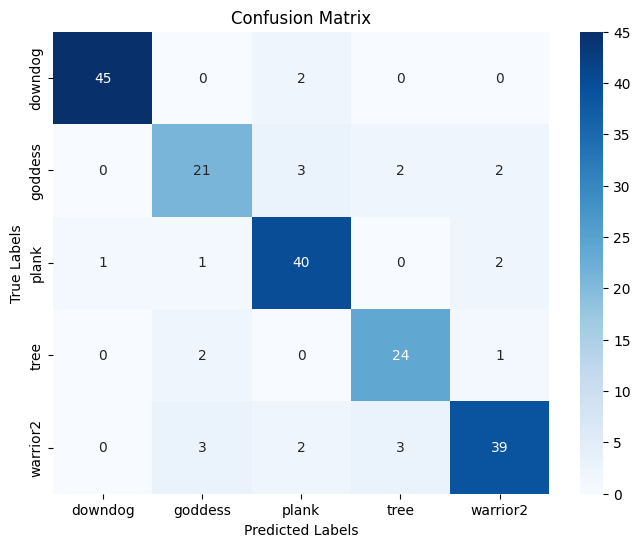

In [ ]:

# Step 4: Model Evaluation
# Apply the trained model to the test data
Y_pred = model.predict(X_test)

# Calculate and display the confusion matrix
conf_matrix = confusion_matrix(Y_test, Y_pred)
print("Confusion Matrix:")
print(conf_matrix)

# Evaluate performance metrics
accuracy = accuracy_score(Y_test, Y_pred)
precision = precision_score(Y_test, Y_pred, average='weighted')
recall = recall_score(Y_test, Y_pred, average='weighted')
f1 = f1_score(Y_test, Y_pred, average='weighted')

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

# Display confusion matrix using seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=model.classes_, yticklabels=model.classes_)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.show()


# SVC is typically trained to convergence
#SVC doesnt have history feature to work with accuracy vs epoch or loss vs epoch graphs

# SVC is prone to overfitting if the dataset is too small or has high dimensionality
